<a href="https://colab.research.google.com/github/carson-edmonds/AAI-510_Life_Expectancy_Prediction/blob/main/Final_Project_Section_3_Team_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement
Life insurance is a way to insure someone's life and in the event of a terminal illness or death. The life insurance policy would pay out to the loved ones of the person insured. The insurer has the job of determining the risk the person faces of death and to determine what sort of premium and terms to put in place for that specific policy. The project will thus be aimed at helping to determine key factors that would influence someone's life expectancy that can then be used to predict the risk and life span of future clients.

Our proposed approach is to use perform regression analysis to determine these key features from WHO life expectancy data.

Dataset: Rajarshi, K. (2018, February 10). Life expectancy (WHO). Kaggle. https://www.kaggle.com/datasets/kumarajarshi/life-expectancy-who

## Summary of Features in Dataset
1. **Country:** Country in Alphabetic

2. **Year:**
Year of data collection

3. **Status_Developed:**
1 == Developed Country, 0 == Developing Country

4. **Life expectancy:**
Life Expectancy in years of age

5. **Adult Mortality:**
Adult Mortality Rates of both sexes (probability of dying between 15 and 60 years per 1000 population)

6. **Infant deaths:**
Number of Infant Deaths per 1000 population

7. **Alcohol:**
Alcohol, recorded per capita (15+) consumption (in litres of pure alcohol)

8. **percentage expenditure:**
Expenditure on health as a percentage of Gross Domestic Product per capita(%)

9. **Hepatitis B:**
Hepatitis B (HepB) immunization coverage among 1-year-olds (%)

10. **Measles:**
Measles - number of reported cases per 1000 population

11. **BMI:**
Average Body Mass Index of entire population

12. **under-five deaths:**
Number of under-five deaths per 1000 population

13. **Polio:**
Polio (Pol3) immunization coverage among 1-year-olds (%)

14. **Total expenditure:**
General government expenditure on health as a percentage of total government expenditure (%)

15. **Diphtheria:**
Diphtheria tetanus toxoid and pertussis (DTP3) immunization coverage among 1-year-olds (%)

16. **HIV/AIDS:**
Deaths per 1 000 live births HIV/AIDS (0-4 years)

17. **GDP:**
Gross Domestic Product per capita (in USD)

18. **Population:**
Population of the Country

19. **thinness 1-19 years:**
Prevalence of thinness among children and adolescents for Age 10 to 19 (% )

20. **thinness 5-9 years:**
Prevalence of thinness among children for Age 5 to 9(%)

21. **Income composition of resources:**
Human Development Index in terms of income composition of resources (index ranging from 0 to 1)

22. **Schooling:**
Number of years of Schooling(years)

In [3]:
#@title Loading the required libraries

import numpy as np # Pandas for array manipulation
import pandas as pd # Pandas for data manipulation
import seaborn as sns # Seaborn for visualizing
import matplotlib.pyplot as plt # Matplotlib for subplots
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler # Import for feature standardization
from sklearn.decomposition import PCA # Import for PCA generation
from sklearn.model_selection import train_test_split,  GridSearchCV # Import train_test_split function
from sklearn import metrics # Import scikit-learn metrics module for accuracy calculation
from scipy.stats import randint # Generate random numbers

import warnings
warnings.filterwarnings("ignore")

In [2]:
!pip install dataprep --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 81.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 69.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 kB 12.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 69.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 65.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 98.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 764.0/764.0 kB 53.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 106.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 24.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [4]:
from dataprep.eda import *
from dataprep.datasets import load_dataset
from dataprep.eda import plot, plot_correlation, plot_missing, plot_diff, create_report

In [45]:
#@title Loading data and viewing it

life_df = pd.read_csv('https://github.com/carson-edmonds/AAI-510_Life_Expectancy_Prediction/raw/main/Life%20Expectancy%20Data.csv')

life_shap = life_df.shape
print("Shape of the dataframe (row, col):",life_shap,"\r\n")

# Show dataframe
life_df

Shape of the dataframe (row, col): (2938, 22) 



,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


#### Purpose of encoding:
The purpose of encoding data is to change the datatype from strings to number type data. This is required for using classifiers.

In [46]:
#@title Encoding data for processing
#Encoding Status of countries Developing or developed
life_df = pd.get_dummies(life_df, columns=['Status'], drop_first=True)

In [56]:
life_df['Country'] = life_df['Country'].astype('category')
life_df['Country'] = life_df['Country'].cat.codes
life_df

,Country,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,...,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling,Status_Developing
0,0,2015,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1
1,0,2014,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1
2,0,2013,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1
3,0,2012,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1
4,0,2011,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,182,2004,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1
2934,182,2003,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1
2935,182,2002,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1
2936,182,2001,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1


#### Purpose of whitespace removal:
The purpose of renaming the feature titles is to remove any whitespace. After calling some features it became apparent that many of the feature names have leading/trailing whitespace that reduces readability in a team setting. Removing this prevents future issues if other team members reference a feature name they do not need to go through the process of figuring out where the whitespace is.


In [57]:
#@title Renaming columns to remove extra whitespace
life_df.columns = life_df.columns.str.strip()
life_df.rename(columns = {'thinness  1-19 years':'thinness 1-19 years'}, inplace = True)

#### Purpose of handling Null values:
The purpose of this section is to replace or remove null values in the data. This needs to be addressed because we can’t do any statistical analysis or run further predictions on the data if there are empty values. In our case we are filling in null values for features that need to be filled, using the mean of the entire feature to fill it with, and removing the data rows that contain null life expectancy values because this is our target variable we do not want to affect it by adding inaccurate values.

In [58]:
#@title Handling Null Values
# Note: If Country and Status columns had null values we would want to replace them before encoding.
#print(life_df.isnull().sum())

life_df= life_df[life_df['Life expectancy'].notna()]

#print(life_df.isnull().sum())
#life_df.shape

mean_cols = [
     'Adult Mortality', 'Alcohol','Hepatitis B', 'BMI',
     'Polio', 'Total expenditure', 'Diphtheria', 'GDP',
     'Population', 'thinness 1-19 years', 'thinness 5-9 years',
     'Income composition of resources', 'Schooling'
 ]

for column in mean_cols:
  life_df[column] = life_df.groupby('Country')[column].transform(
    lambda grp: grp.fillna(grp.interpolate(limit_direction='both'))
)
     #life_df[column] = life_df[column].fillna(life_df[column].mean())

#### Statistical Analysis:
Below we are now looking at how data may be correlated as well as visualizing some relationships. This will help inform decisions regarding feature selection and give us a better understanding of the data.


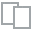
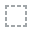
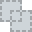
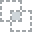
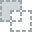
...
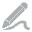
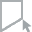
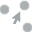
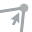
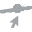

In [59]:
#@title Correlation Overview of Data
plot_correlation(life_df)


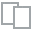
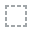
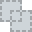
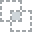
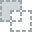
...
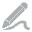
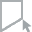
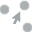
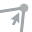
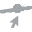

In [60]:
#@markdown ###Correlation plot comparing all features to target life expectancy.
plot_correlation(life_df, "Life expectancy")

#### Reviewing results of correlation:
The purpose of this section is to take a look at how features are correlated. There is a further look in the EDA report towards the bottom of the data processing section. This shows us information about what is mutually related to life expectancy. The main things we can take from here are that Schooling seems to be positively correlated with life expectancy, as well as Income composition of resources and BMI. These might be useful to select in the feature selection process. We can also see what has a high negative correlation. We see HIV/AIDS, Adult Mortality, and developing status, all have a high negative mortality and may be good to consider for feature selection.



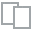
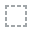
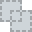
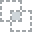
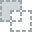
...
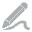
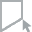
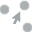
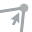
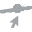

In [61]:
#@title Life expectancy stats
#@markdown Here we are looking further at some statistical information regarding life expectancy.
plot(life_df, "Life expectancy")

#### Results of analysis:
I think the main takeaways from this section are looking at the mean of around 70 years old and the histogram showing the ages distribution is skewed left. Keeping this information in mind and then comparing it to different subsets of data such as how this distribution might look for those only in developing countries or only those with certain vaccines could be interesting.



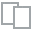
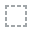
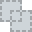
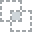
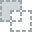
...
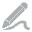
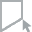
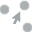
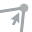
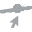

In [62]:
#@title Developing and Developed Country Stats
#@markdown Here we are looking further at some statistical information regarding country developmen status.

plot(life_df, "Status_Developing")

#### Results of analysis:
The main takeaway from this is that we have much more data on developing countris than we do on deveoped countries. Comparing the two against other features may yield some good information but we will need to keep in mind the amount of data available on developed countries is much less and may lead to inaccurate representations being drawn compared to the real-world.

## Visualizing relationships between life expectancy and other features


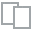
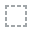
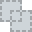
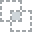
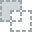
...
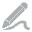
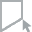
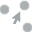
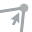
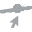

In [63]:
#@title Total Expenditure versus Life expectancy
#@markdown Here we are looking further at some relationships between life expectancy and other features.

plot(life_df, "Total expenditure", "Life expectancy")

#### Results of analysis:
Looking at total expenditure versus life expectancy, we see there isn’t any strong trend. There may be some outliers towards the right side of the graph but overall it seems that a group can spend the same amount and have a short or long life. Conclusion here is it may not be a good feature to consider when predicting life expectancy.


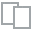
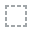
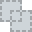
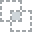
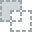
...
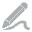
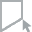
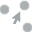
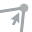
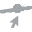

In [64]:
#@title Status Developing versus Life expectancy
plot(life_df, "Status_Developing", "Life expectancy")

#### Results of analysis:
Looking at Status Developing versus Life expectancy, we can see that first off we have a lot more data for developing countries. Keeping that in mind it looks like developed countries have a longer life expectancy. It looks like the variance is also going to be much lower. We see with developing countries in that large range of 45-65 there is data whereas with developed countries life expectancy is only recorded greater than 65. This may indicate that you would live longer if you are in a developed country but there are still people in developing countries with life expectancies in that greater than 65 area and with the difference in data points it is not a clear indication of life expectancy.

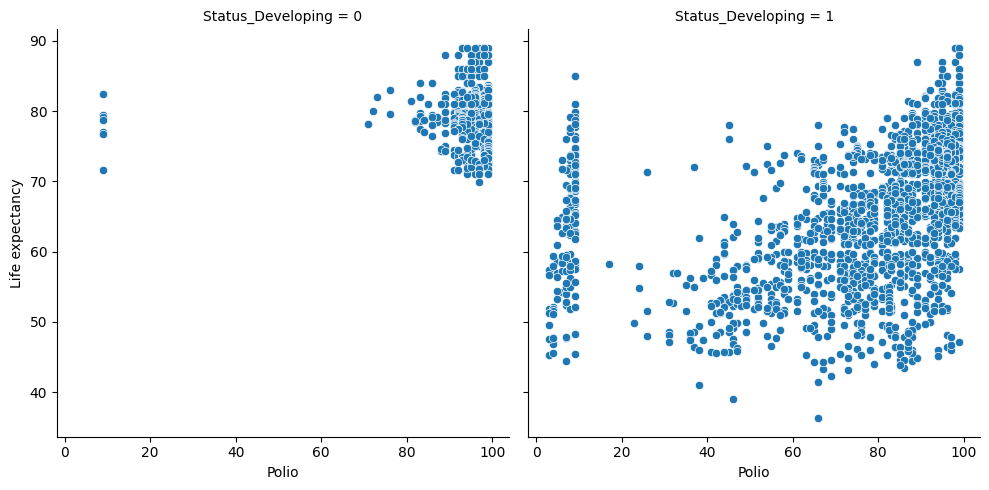

In [65]:
#@title Relationship between polio vaccine and life expectancy seperated by developing status
# Create a visualization
sns.relplot(
    data=life_df,
    x="Polio", y="Life expectancy", col="Status_Developing",
)

#### Results of analysis:
Looking at Polio vaccine percent versus life expectancy we can see a clear linear trend, the higher the percentage of coverage, the longer the life expectancy. Splitting it up based on developing status gives us a look at how the two groups compare. We can again see with higher coverage life expectancy is longer. Again there is less data for developed countries. Another observation is that there may be some outliers here on the left side where they are not following the linear trend and if this feature was used for modeling it may be worthwhile to remove these outliers to improve performance.

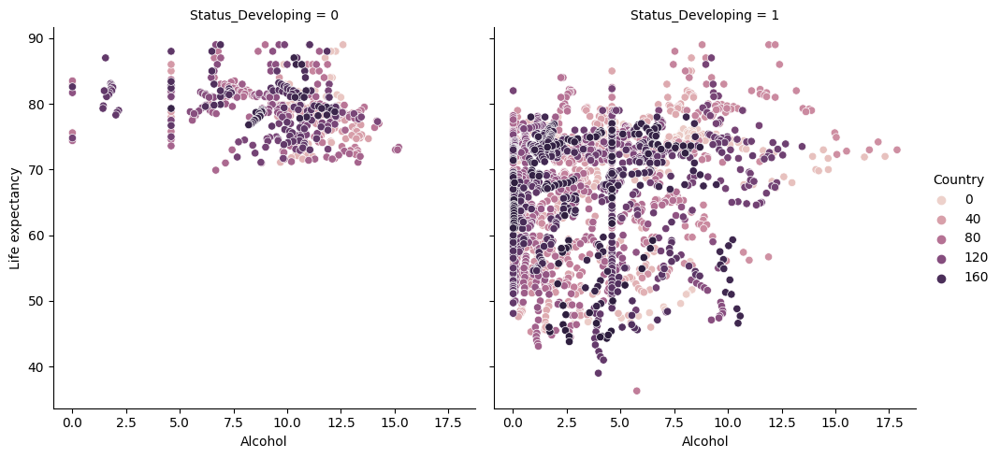

In [66]:
sns.relplot(
    data=life_df,
    x="Alcohol", y="Life expectancy", col="Status_Developing", hue="Country"
)

#### Results of analysis:
Looking at alcohol use versus life expectancy It does not seem that there is a strong trend. It appears there may be some outliers from the main group of data but otherwise visually it doesn’t seem to be a noteworthy feature.


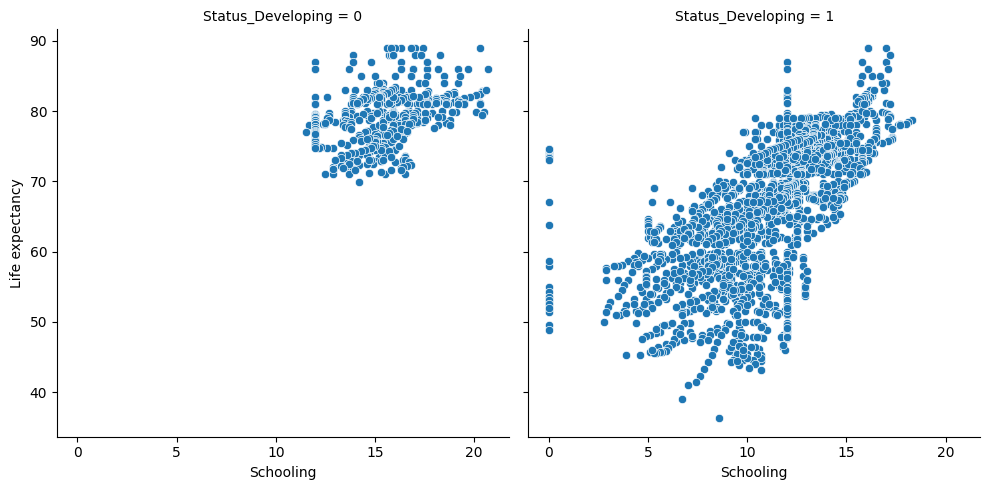

In [67]:
sns.relplot(
    data=life_df,
    x="Schooling", y="Life expectancy", col="Status_Developing",
)

#### Results of analysis:
Looking at schooling versus life expectancy, it looks like there is a strong linear trend. The higher the schooling the longer the life expectancy. This is to be expected based on our high correlation we saw earlier.


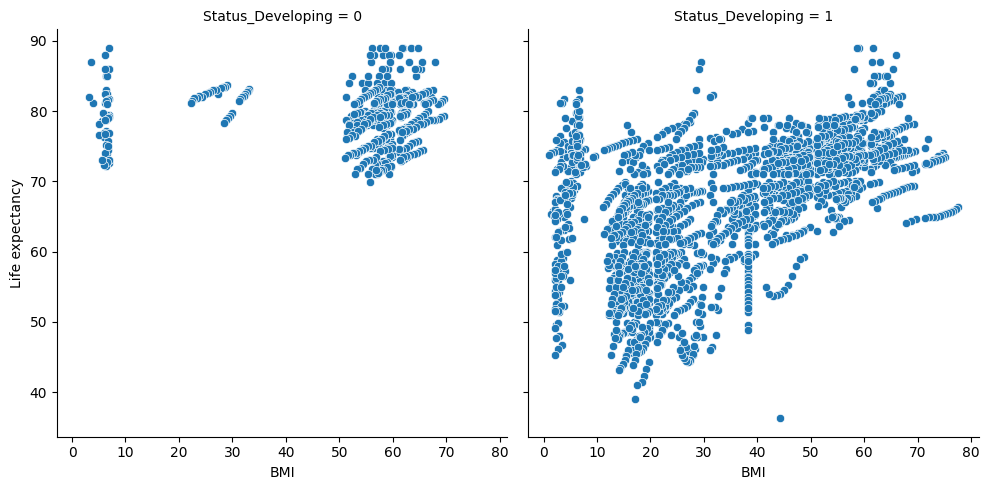

In [68]:
sns.relplot(
    data=life_df,
    x="BMI", y="Life expectancy", col="Status_Developing",
)

#### Results of analysis:
Looking at the BMI versus life expectancy it seems that there is a linear trend as BMI increases so does life expectancy. This agrees with our correlation analysis as well. On the practical side this is interesting because higher BMI’s are usually not a good thing in terms of tracking the health of a person. I would have expected a parabolic relationship but it could be pointing to the idea that the higher your BMI in a developing country the more food you are getting and therefore not starving which would definitely impact life expectancy.


DataPrep Report
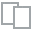
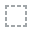
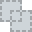
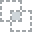
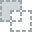
...
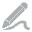
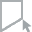
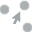
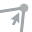
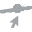

In [69]:
#@markdown Creating this report will allow quick reference of feature relationships and statistics.
create_report(life_df)

#### Insights from report:
From this report we can get all kinds of interesting information. We can click through different features to see the distributions and other statistical data on each feature. Such as looking at the average schooling across the data, or GDP statistics. This allows us to review some visual and high level statistical information to inform feature engineering decisions. Adding this report in allows us to easily review features without creating new visuals.


# Feature Engineering

Country and year are used to categorize the data and provide no significant information, they are removed. Due to the correlation plot found in the previous section, under-five deaths was removed as it has a high correlation with infant deaths and thinness 5-9 years was removed as it is contained with thinness 1-19. Life expectancies are rounded to a whole number to allow for easier classification.

In [21]:
life_df = life_df.drop(['Country', 'Year', 'under-five deaths', 'thinness 5-9 years'], axis=1)
life_df = life_df.round({'Life expectancy':0})
life_df

,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,Income composition of resources,Schooling,Status_Developing
0,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,0.479,10.1,1
1,60.0,271.0,64,0.01,73.523582,62.0,492,18.6,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,0.476,10.0,1
2,60.0,268.0,66,0.01,73.219243,64.0,430,18.1,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,0.470,9.9,1
3,60.0,272.0,69,0.01,78.184215,67.0,2787,17.6,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,0.463,9.8,1
4,59.0,275.0,71,0.01,7.097109,68.0,3013,17.2,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,0.454,9.5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,44.0,723.0,27,4.36,0.000000,68.0,31,27.1,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,0.407,9.2,1
2934,44.0,715.0,26,4.06,0.000000,7.0,998,26.7,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,0.418,9.5,1
2935,45.0,73.0,25,4.43,0.000000,73.0,304,26.3,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,0.427,10.0,1
2936,45.0,686.0,25,1.72,0.000000,76.0,529,25.9,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,0.427,9.8,1


PCA is used to visulaize the spread of data in 2D. Can be removed for final presentation does not add much information overall.

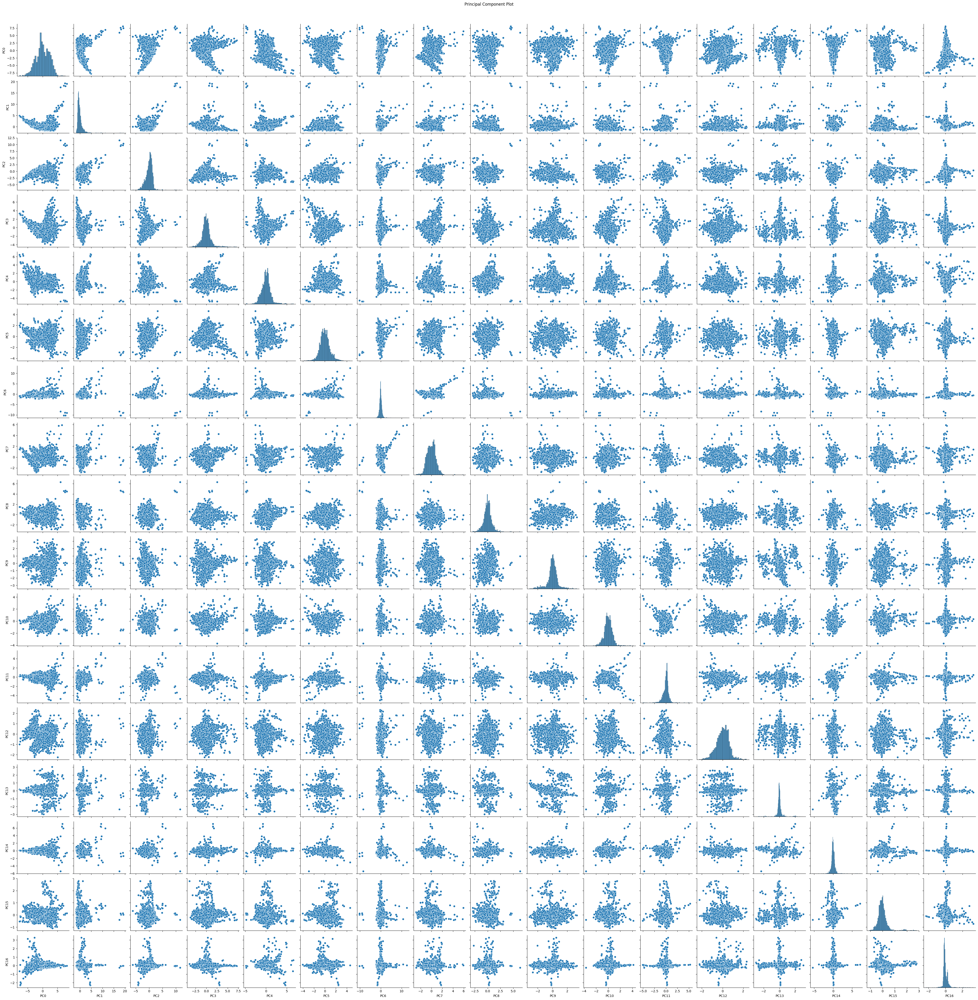

<Figure size 1200x800 with 0 Axes>

In [22]:
y = life_df['Life expectancy']
x = life_df.drop(columns=['Life expectancy'])

scaler = StandardScaler()
stdx = scaler.fit_transform(x)
x = pd.DataFrame(data=stdx, columns=x.columns)

pca = PCA(n_components=17, random_state=10)
df_pca = pca.fit_transform(x)

pca_col = []
for i in range(0, len(df_pca[0])):
  pca_col.append("PC"+str(i))
pca_db_df = pd.DataFrame(data=df_pca, columns=pca_col)
pca_plot = sns.pairplot(pca_db_df)
plt.figure(figsize=(12,8))
pca_plot.fig.suptitle('Principal Component Plot', y=1.01)
plt.show()

Explained variance is plotted to illustrate the varaince in dataset attributed to each principal component.

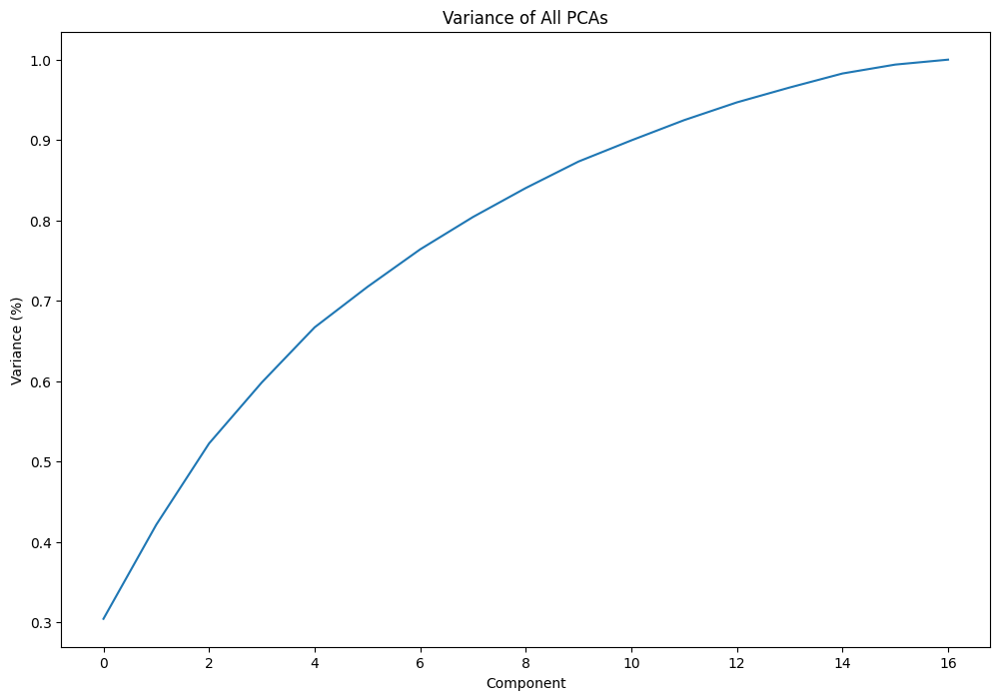

In [23]:
cum_sum_eigenvalues = np.cumsum(pca.explained_variance_ratio_)
plt.figure(figsize=(12,8))
plt.plot(cum_sum_eigenvalues)
plt.title('Variance of All PCAs')
plt.xlabel('Component')
plt.ylabel('Variance (%)')
plt.show()

# Feature Selection

In [24]:
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

View model performance before feature selection.

Train Accuracy: 0.17506404782237403
Test Accuracy: 0.15017064846416384
0.06486600940043798
0.15017064846416384
0.04702519474224732


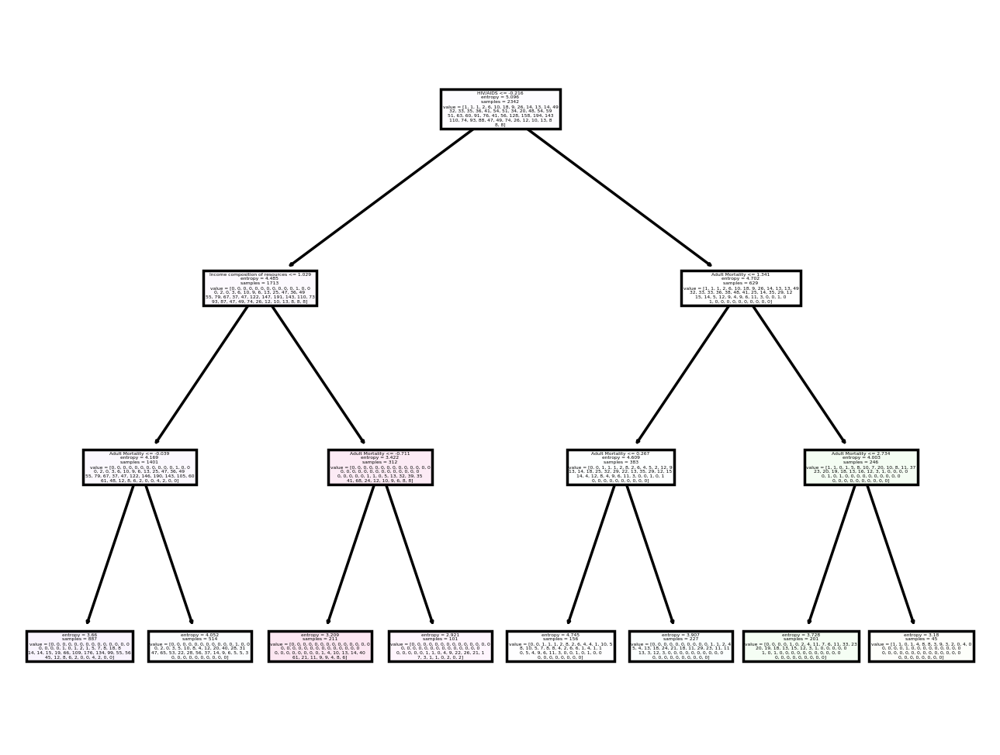

In [25]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1)
clf = tree.DecisionTreeClassifier(max_depth=3, criterion='entropy')
clf = clf.fit(X_train, y_train)

pred_train = clf.predict(X_train)
pred_test = clf.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))
print(metrics.precision_score(y_test, pred_test, average='weighted'))

#Visualizing the Tree
plt.rcParams['figure.dpi'] = 250
f_names=list(x.columns)
tree.plot_tree(clf, filled=True, feature_names=f_names)
plt.show()

In [26]:
rf = RandomForestClassifier(max_depth=3, random_state=10)
rf = rf.fit(X_train, y_train)

pred_train = rf.predict(X_train)
pred_test = rf.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))
print(metrics.precision_score(y_test, pred_test, average='weighted'))

Train Accuracy: 0.2327070879590094
Test Accuracy: 0.18600682593856654
0.09766070214016837
0.18600682593856654
0.13092083911615923


In [27]:
gbc = GradientBoostingClassifier(learning_rate=1.0, max_depth=3, random_state=0)
gbc = gbc.fit(X_train, y_train)

pred_train = gbc.predict(X_train)
pred_test = gbc.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))
print(metrics.precision_score(y_test, pred_test, average='weighted'))

Train Accuracy: 0.0448334756618275
Test Accuracy: 0.03924914675767918
0.028346872203527492
0.03924914675767918
0.045238088631459485


View features with highest importance based on the random forest tree, model with the best performance metrics.

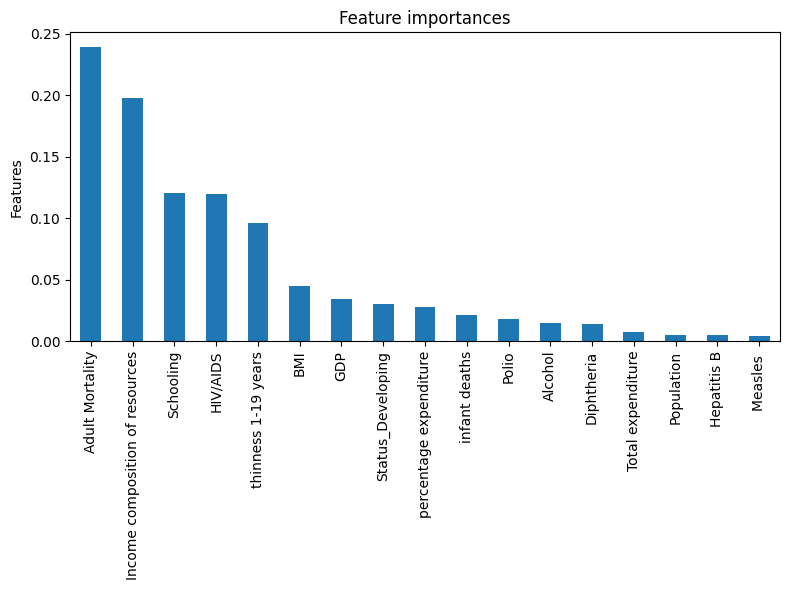

In [28]:
features = pd.Series(rf.feature_importances_, index=x.columns)
features.sort_values(ascending=False, inplace=True)
plt.rcParams['figure.dpi'] = 100
fig, ax = plt.subplots(figsize=(8,6))
features.head(19).plot.bar(ax=ax)
ax.set_title("Feature importances")
ax.set_ylabel("Mean decrease in impurity")
ax.set_ylabel("Features")
fig.tight_layout()
plt.show()

Create new dataframe with features that are most significant. Graph from above a bit of experimentation proves 6 features has best performance metrics.

In [29]:
df = life_df[['Life expectancy', 'Income composition of resources', 'Adult Mortality',
               'HIV/AIDS','Schooling', 'thinness 1-19 years', 'BMI']]

y = df['Life expectancy']
x = df.drop(columns=['Life expectancy'])
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1)

In [30]:
clf = tree.DecisionTreeClassifier(max_depth=3, criterion='entropy')
clf = clf.fit(X_train, y_train)

pred_train = clf.predict(X_train)
pred_test = clf.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))
print(metrics.precision_score(y_test, pred_test, average='weighted'))

Train Accuracy: 0.17506404782237403
Test Accuracy: 0.15017064846416384
0.06486600940043798
0.15017064846416384
0.04702519474224732


In [31]:
rf = RandomForestClassifier(max_depth=3, random_state=10)
rf = rf.fit(X_train, y_train)

pred_train = rf.predict(X_train)
pred_test = rf.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))
print(metrics.precision_score(y_test, pred_test, average='weighted'))

Train Accuracy: 0.22758326216908625
Test Accuracy: 0.19965870307167236
0.11585255603746011
0.19965870307167236
0.1296971832184388


In [32]:
gbc = GradientBoostingClassifier(learning_rate=1.0, max_depth=3, random_state=0)
gbc = gbc.fit(X_train, y_train)

pred_train = gbc.predict(X_train)
pred_test = gbc.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))
print(metrics.precision_score(y_test, pred_test, average='weighted'))

Train Accuracy: 0.036720751494449186
Test Accuracy: 0.02901023890784983
0.012739972860317809
0.02901023890784983
0.010392490266376888


Look at oversampling due to non-uniform data and run models again.

In [33]:
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from numpy import mean
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from imblearn.over_sampling import RandomOverSampler

In [34]:
sm = SMOTE(random_state=10, k_neighbors=3)
ros = RandomOverSampler(random_state=10)
x_res, y_res = ros.fit_resample(x,y)
X_train, X_test, y_train, y_test = train_test_split(x_res, y_res, test_size=0.2, random_state=1)

In [35]:
model_scores = {}

In [36]:
clf = tree.DecisionTreeClassifier(max_depth=3, criterion='entropy')
clf = clf.fit(X_train, y_train)

pred_train = clf.predict(X_train)
pred_test = clf.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))

dtc_precision = metrics.precision_score(y_test, pred_test, average='weighted')
model_scores['DTC'] = dtc_precision

print(dtc_precision)

Train Accuracy: 0.13711702661978906
Test Accuracy: 0.13258336681398153
0.04363223335803024
0.13258336681398153
0.027200318235357533


In [37]:
rf = RandomForestClassifier(max_depth=3, random_state=10)
rf = rf.fit(X_train, y_train)

pred_train = rf.predict(X_train)
pred_test = rf.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))

rfc_precision = metrics.precision_score(y_test, pred_test, average='weighted')
model_scores['RFC'] = rfc_precision

print(rfc_precision)

Train Accuracy: 0.253741838272225
Test Accuracy: 0.24708718360787466
0.19425311266723003
0.24708718360787466
0.24459097181731806


In [38]:
gbc = GradientBoostingClassifier(learning_rate=1.0, max_depth=3, random_state=0)
gbc = gbc.fit(X_train, y_train)

pred_train = gbc.predict(X_train)
pred_test = gbc.predict(X_test)

print("Train Accuracy:", metrics.accuracy_score(y_train, pred_train))
print("Test Accuracy:", metrics.accuracy_score(y_test, pred_test))
print(metrics.f1_score(y_test, pred_test, average='weighted'))
print(metrics.recall_score(y_test, pred_test, average='weighted'))

gbc_precision = metrics.precision_score(y_test, pred_test, average='weighted')
model_scores['GBC'] = gbc_precision

print(gbc_precision)

Train Accuracy: 0.03264691109994977
Test Accuracy: 0.03214142225793491
0.009367074775169737
0.03214142225793491
0.008282785095757757


In [39]:
from sklearn.naive_bayes import GaussianNB
nbc = GaussianNB()
nbc = nbc.fit(X_train, y_train)

pred_train  = nbc.predict(X_train)
pred_test = nbc.predict(X_test)

print("Train Accuracy:", round(metrics.accuracy_score(y_train, pred_train),3))
print("Test Accuracy:", round(metrics.accuracy_score(y_test, pred_test),3))
print("F1 Score:", round(metrics.f1_score(pred_test, y_test, average="weighted"),3))
print("Recall Score:", round(metrics.recall_score(pred_test, y_test, average="weighted"),3))

gnb_precision = round(metrics.precision_score(pred_test, y_test, average="weighted"),3)
model_scores['GNB'] = gnb_precision

print("Precision Score:", gnb_precision)

Train Accuracy: 0.242
Test Accuracy: 0.229
F1 Score: 0.253
Recall Score: 0.229
Precision Score: 0.375


In [40]:
from sklearn import svm
clf = svm.SVC()
clf.fit(X_train, y_train)

pred_train = clf.predict(X_train)
pred_test = clf.predict(X_test)

print("Train Accuracy:", round(metrics.accuracy_score(y_train, pred_train),3))
print("Test Accuracy:", round(metrics.accuracy_score(y_test, pred_test),3))
print("F1 Score:", round(metrics.f1_score(pred_test, y_test, average="weighted"),3))
print("Recall Score:", round(metrics.recall_score(pred_test, y_test, average="weighted"),3))
print("Precision Score:", round(metrics.precision_score(pred_test, y_test, average="weighted"),3))

svm_precision = round(metrics.precision_score(pred_test, y_test, average="weighted"),3)
model_scores['SVC'] = svm_precision

print("Precision Score:", svm_precision)

Train Accuracy: 0.173
Test Accuracy: 0.178
F1 Score: 0.225
Recall Score: 0.178
Precision Score: 0.519
Precision Score: 0.519


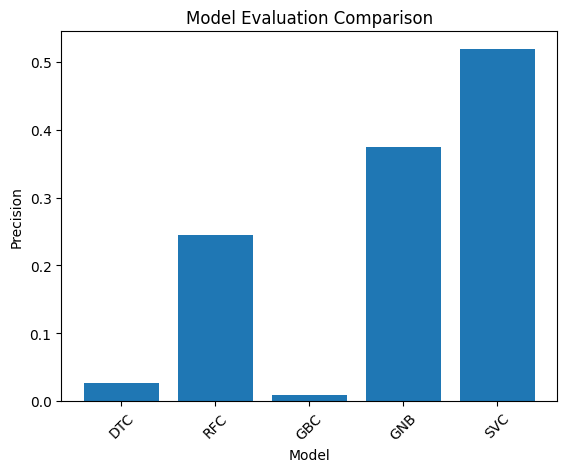

In [41]:
plt.bar(list(model_scores.keys()), list(model_scores.values()))
plt.xlabel('Model')
plt.ylabel('Precision')
plt.xticks(rotation=45)
plt.title('Model Evaluation Comparison')
plt.show()

### Grid Search

In [ ]:
rf = RandomForestClassifier()
param_grid = {
    'n_estimators': [100, 500, 1000],
    'criterion': ['gini', 'entropy'],
    'max_depth': [5, 7, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', None]
}
grid_search = GridSearchCV(
    rf,
    param_grid,
    cv=3
)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_score = abs(grid_search.best_score_)
print("Best parameters:", best_params)
print("Best Score: ", best_score)


In [ ]:
gbc = GradientBoostingClassifier()
param_grid = {
    'n_estimators': [100, 200, 1000],
    'learning_rate': [0.1, 0.01, 0.001],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 3, 4],
    'min_samples_leaf': [1, 2, 3],
    'max_features': ['sqrt', None]
}
grid_search = GridSearchCV(
    gbc,
    param_grid,
    cv=3
)

grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_score = abs(grid_search.best_score_)
print("Best parameters:", best_params)
print("Best Score: ", best_score)

In [ ]:
nbc = GaussianNB()
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7]
}
grid_search = GridSearchCV(
    nbc,
    param_grid,
    cv=3
)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_score = abs(grid_search.best_score_)
print("Best parameters:", best_params)
print("Best Score: ", best_score)

In [ ]:
svc = svm.SVC()
param_grid = {
    'C': [0.1, 1, 5],
    'kernel': ['linear', 'rbf'],
    'gamma': ['scale', 'auto', 0.1, 1]
}
grid_search = GridSearchCV(
    svc,
    param_grid,
    cv=3
)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_score = abs(grid_search.best_score_)
print("Best parameters:", best_params)
print("Best Score: ", best_score)